## Introduction
The purpose of this notebook is to show how to load the Dinov2 finetunes model provided by the organisers of the PlantCLEF2025 competition and infer on a random test image.

Import libraries

In [1]:
# Scientific Computing
import numpy as np
# Data manipulation
import pandas as pd
# Navigating files
import os
# Image handling
from PIL import Image
# Data Visualization
import matplotlib.pyplot as plt
# PyTorch Image Models - collection of pre-trained computer vision models
import timm 
# PyTorch
import torch

In [2]:
df_species_ids = pd.read_csv('/kaggle/input/plantclef-2025/species_ids.csv')
df_metadata = pd.read_csv('/kaggle/input/plantclef-2025/PlantCLEF2024_single_plant_training_metadata.csv', sep=';', dtype={'partner': str})
id_to_species = df_metadata[['species_id', 'species']].drop_duplicates().set_index('species_id')

Load random image

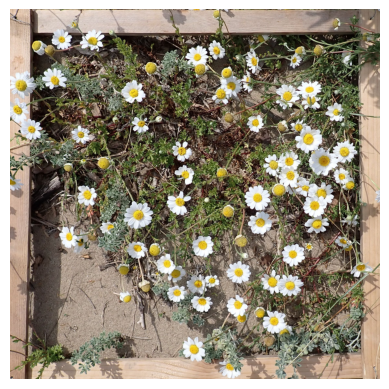

In [3]:
img = Image.open('/kaggle/input/plantclef-2025/PlantCLEF2025_test_images/PlantCLEF2025_test_images/GUARDEN-CBNMed-30-4-16-3-20240428.jpg')
plt.imshow(img)
plt.axis('off')
plt.show()

In [9]:
# Define the path to the test images directory
test_image_dir = '/kaggle/input/plantclef-2025/PlantCLEF2025_test_images/PlantCLEF2025_test_images/'

# List all files in the directory and get the count
num_test_images = len(os.listdir(test_image_dir))

# Print the total number
print(f'Total number of test images: {num_test_images}')

Total number of test images: 2105


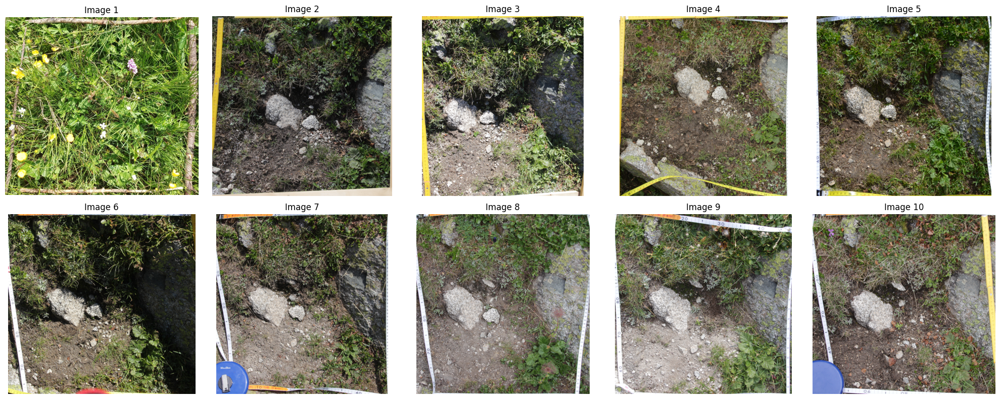

In [13]:
# Get a list of all image filenames and sort them to ensure consistency
image_files = sorted(os.listdir(test_image_dir))

# Select the first 10 image files
first_10_images = image_files[:10]

# Create a figure and a set of subplots (2 rows, 5 columns)
fig, axes = plt.subplots(2, 5, figsize=(20, 8))

# Flatten the axes array to easily iterate over it
axes = axes.flatten()

# Loop through the first 10 images and their corresponding axes
for i, filename in enumerate(first_10_images):
    # Construct the full image path
    img_path = os.path.join(test_image_dir, filename)
    
    # Open the image
    img = Image.open(img_path)
    
    # Display the image on the i-th subplot
    axes[i].imshow(img)
    axes[i].axis('off') # Turn off the axis
    axes[i].set_title(f'Image {i+1}') # Optional: add a title

plt.tight_layout() # Adjust subplots to give some padding
plt.show()

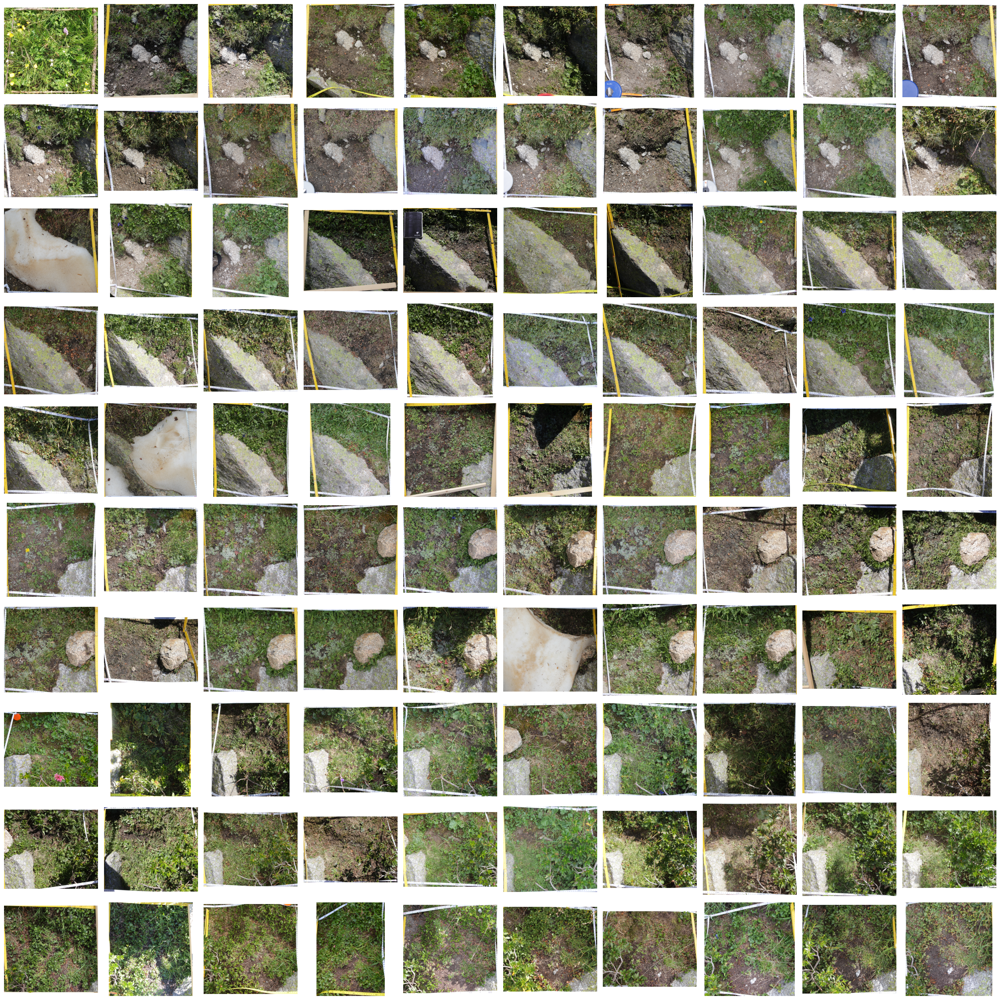

In [12]:
# Get a list of all image filenames and sort them
image_files = sorted(os.listdir(test_image_dir))

# Select the first 100 image files
first_100_images = image_files[:100]

# Create a figure and a set of subplots (10 rows, 10 columns)
# A larger figsize is needed to see the images clearly
fig, axes = plt.subplots(10, 10, figsize=(25, 25))

# Flatten the 10x10 grid of axes for easy iteration
axes = axes.flatten()

# Loop through the first 100 images and their corresponding axes
for i, filename in enumerate(first_100_images):
    # Construct the full image path
    img_path = os.path.join(test_image_dir, filename)
    
    # Open the image
    img = Image.open(img_path)
    
    # Display the image on the i-th subplot
    axes[i].imshow(img)
    axes[i].axis('off') # Turn off the axis ticks and labels

plt.tight_layout() # Adjust subplots to prevent overlap
plt.show()

In [4]:
img.size

(2274, 2274)

Load model

In [5]:
device = torch.device('cuda')
model = timm.create_model('vit_base_patch14_reg4_dinov2.lvd142m',
                          pretrained=False,
                          num_classes=len(df_species_ids),
                          checkpoint_path='/kaggle/input/dinov2_patch14_reg4_onlyclassifier_then_all/pytorch/default/3/model_best.pth.tar')
model = model.to(device)
model = model.eval()

Print the top 5 scores.

In [6]:
# get model specific transforms (normalization, resize)
data_config = timm.data.resolve_model_data_config(model)
transforms = timm.data.create_transform(**data_config, is_training=False)

with torch.no_grad():
    if img != None:
        img = transforms(img).unsqueeze(0)
        img = img.to(device)
        output = model(img)  # unsqueeze single image into batch of 1
        top5_probabilities, top5_class_indices = torch.topk(output.softmax(dim=1), k=5)
        top5_probabilities = top5_probabilities.cpu().detach().numpy()
        top5_class_indices = top5_class_indices.cpu().detach().numpy()
    
        for proba, cid in zip(top5_probabilities[0], top5_class_indices[0]):
            species_id = df_species_ids.iloc[cid].item()
            species = id_to_species.loc[species_id].item()
            print(species_id, species, proba)


1394664 Anthemis tomentosa L. 0.10699353
1398319 Anthemis ruthenica M.Bieb. 0.06801893
1357220 Anthemis cretica L. 0.06224244
1357227 Anthemis maritima L. 0.04566524
1357236 Anthemis secundiramea Biv. 0.03889915


In [14]:
# get model specific transforms (normalization, resize)
data_config = timm.data.resolve_model_data_config(model)
transforms = timm.data.create_transform(**data_config, is_training=False)

with torch.no_grad():
    if img != None:
        img = transforms(img).unsqueeze(0)
        img = img.to(device)
        output = model(img)  # unsqueeze single image into batch of 1
        
        # --- MODIFICATION IS HERE ---
        # Changed k=5 to k=10 to get the top 10 predictions
        top10_probabilities, top10_class_indices = torch.topk(output.softmax(dim=1), k=10)
        
        top10_probabilities = top10_probabilities.cpu().detach().numpy()
        top10_class_indices = top10_class_indices.cpu().detach().numpy()
    
        # Loop through the new top 10 results
        for proba, cid in zip(top10_probabilities[0], top10_class_indices[0]):
            species_id = df_species_ids.iloc[cid].item()
            species = id_to_species.loc[species_id].item()
            print(f"ID: {species_id:<5} | Species: {species:<40} | Probability: {proba:.4f}")

ID: 1412857 | Species: Omalotheca supina (L.) DC.               | Probability: 0.1224
ID: 1529289 | Species: Sedum pedicellatum Boiss. & Reut.        | Probability: 0.0347
ID: 1664563 | Species: Ranunculus nigrescens Freyn              | Probability: 0.0272
ID: 1646497 | Species: Plantago nivalis Boiss.                  | Probability: 0.0208
ID: 1394866 | Species: Potentilla nivea L.                      | Probability: 0.0190
ID: 1394911 | Species: Primula integrifolia L.                  | Probability: 0.0173
ID: 1392608 | Species: Geum montanum L.                         | Probability: 0.0173
ID: 1397535 | Species: Gentiana verna L.                        | Probability: 0.0155
ID: 1362025 | Species: Leucanthemopsis pallida (Mill.) Heywood  | Probability: 0.0140
ID: 1392407 | Species: Gagea serotina (L.) Ker Gawl.            | Probability: 0.0132


As observed from the predictions, since the model is trained on a mono-label dataset, two predicted species could both be present in the quadrat, or the model might be uncertain between them.